In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import tensorflow as tf
from tensorflow.keras import layers, losses
from tensorflow.keras.models import Model
import random

In [3]:
dataset_raw = tf.keras.utils.image_dataset_from_directory("/Users/macbook/Documents/Python/Untitled Folder/archive (1)/", 
                                                 labels=None, seed=42, image_size=(128, 128), crop_to_aspect_ratio=True)


Found 202599 files belonging to 1 classes.


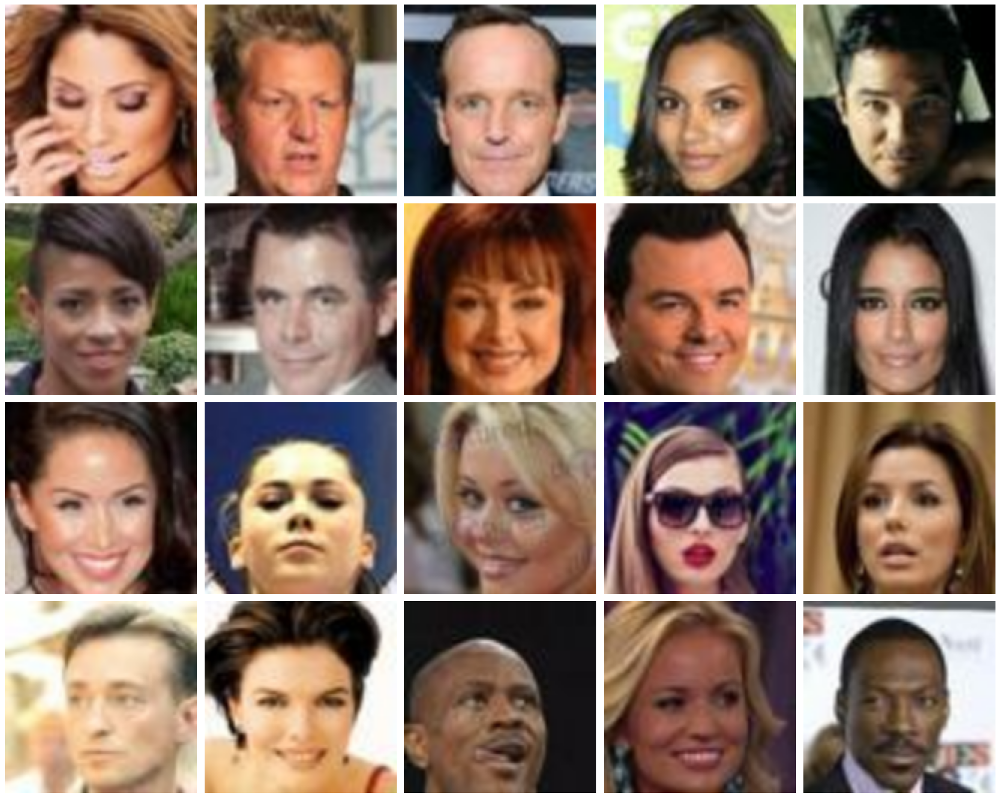

In [4]:
def plot_image_batch(batch, stride=1, rows=4, cols=5):
    plt.figure(figsize=(4*cols, 4*rows))
    for images in batch:
        for i in range(rows * cols):
            ax = plt.subplot(rows, cols, i + 1)
            # display every nth image in the batch
            idx = stride*i
            image = images[idx]
            plt.imshow(image.numpy().astype("uint8"))
            plt.axis("off")
        break
    plt.tight_layout()

plot_image_batch(dataset_raw.take(1))

In [5]:
def preprocess(image):
    # normalize
    normalized = image / 255.
    # return image and label (same as image for this task)
    return normalized, normalized
    
dataset = dataset_raw.map(preprocess)

# Model

In [6]:
class Autoencoder(tf.keras.models.Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential(name="encoder", layers=[
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=32, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=32, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=64, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=64, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=128, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=128, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=256, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2D(filters=256, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.GlobalMaxPooling2D(),
            tf.keras.layers.Dense(latent_dim, activity_regularizer=tf.keras.regularizers.L2(0.01)),
        ])
        self.decoder = tf.keras.Sequential(name="decoder", layers=[            
            tf.keras.layers.InputLayer(input_shape=(latent_dim,)),
            tf.keras.layers.Reshape(target_shape=(1, 1, latent_dim)),
            tf.keras.layers.UpSampling2D(size=(4,4)),
            tf.keras.layers.Conv2DTranspose(filters=256, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=256, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=128, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=128, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=64, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=32, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=32, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=16, kernel_size=3, strides=1, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=16, kernel_size=3, strides=2, padding='same', activation='relu'),
            tf.keras.layers.Conv2DTranspose(filters=3, kernel_size=3, strides=1, padding='same', activation='sigmoid'),
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded
    

def get_model(latent_dim):
    model = Autoencoder(latent_dim)
    optimizer = tf.keras.optimizers.Adam(learning_rate=5e-4)
    # loss = tf.keras.losses.BinaryCrossentropy()
    loss = tf.keras.losses.MeanSquaredError()
    model.compile(optimizer=optimizer, loss=loss)
    model.build((None, 128, 128, 3))
    model.encoder.summary()
    model.decoder.summary()
    model.summary()
    return model

LATENT_DIM = 64
model = get_model(LATENT_DIM)

Model: "encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 16)        2320      
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 32)        9248      
                                                                 
 conv2d_4 (Conv2D)           (None, 32, 32, 64)        18496     
                                                                 
 conv2d_5 (Conv2D)           (None, 16, 16, 64)        36928     
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       7385

In [7]:
TRAIN_BATCHES=512
TEST_BATCHES=32

# reduce size of dataset for faster training
ds_train = dataset.take(TRAIN_BATCHES).cache().shuffle(128).prefetch(buffer_size=tf.data.AUTOTUNE)
ds_test = dataset.take(TEST_BATCHES).cache().prefetch(buffer_size=tf.data.AUTOTUNE)

In [8]:
EPOCHS=20

reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=10, verbose=1, min_lr=5e-5)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=15, mode="min", verbose=1)

history = model.fit(ds_train, epochs=EPOCHS, validation_data=ds_test,
                   callbacks=[reduce_lr])

Epoch 1/20
512/512 [==============================] - 2276s 4s/step - loss: 0.0444 - val_loss: 0.0199 - lr: 5.0000e-04
Epoch 2/20
512/512 [==============================] - 1276s 2s/step - loss: 0.0181 - val_loss: 0.0159 - lr: 5.0000e-04
Epoch 3/20
512/512 [==============================] - 1742s 3s/step - loss: 0.0151 - val_loss: 0.0142 - lr: 5.0000e-04
Epoch 4/20
512/512 [==============================] - 1821s 4s/step - loss: 0.0137 - val_loss: 0.0128 - lr: 5.0000e-04
Epoch 5/20
512/512 [==============================] - 2051s 4s/step - loss: 0.0123 - val_loss: 0.0113 - lr: 5.0000e-04
Epoch 6/20
512/512 [==============================] - 2033s 4s/step - loss: 0.0110 - val_loss: 0.0104 - lr: 5.0000e-04
Epoch 7/20
512/512 [==============================] - 11368s 22s/step - loss: 0.0102 - val_loss: 0.0096 - lr: 5.0000e-04
Epoch 8/20
512/512 [==============================] - 1430s 3s/step - loss: 0.0097 - val_loss: 0.0092 - lr: 5.0000e-04
Epoch 9/20
512/512 [==========================

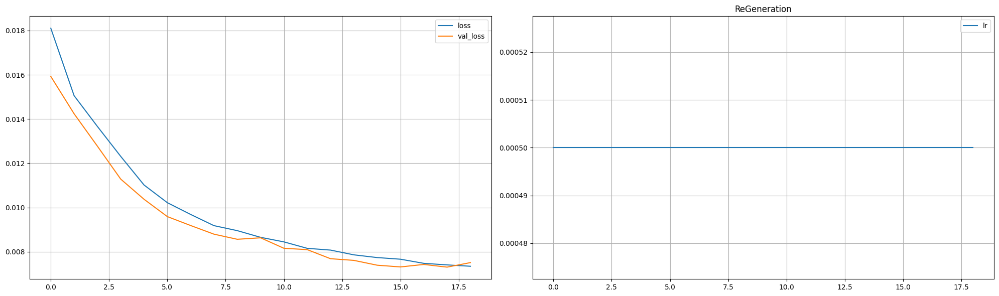

In [16]:
def plot_history(history, start=0):
    PLOTS = ["loss", "lr"]

    fig, axis = plt.subplots(1, len(PLOTS), figsize=(20, 6))
    for plot, ax in zip(PLOTS, axis.flatten()):
        for label, data in history.items():
            if plot in label:
                ax.plot(data[start:], label=label)
                plt.title("Regeneration")
        ax.legend()
        ax.grid()
    plt.tight_layout()
    plt.title("ReGeneration")
    plt.show()
    
plot_history(history.history, start=1)

# Comparative Analysis

How well can the model recreate a given input from the latent space representation?

In [17]:
import math

In [18]:
# Take a few images from the test set in numpy array form
(test_images, test_images_target) = ds_test.unbatch().batch(1024).take(1).get_single_element()

In [19]:
encoded_imgs = model.encoder(test_images)
decoded_imgs = model.decoder(encoded_imgs)

In [20]:
def plot_batch(batch, cols=10, max_img=None):
    rows = math.ceil(float(len(batch)) / cols)
    plt.figure(figsize=(20, 20/cols*rows))
    for i, image in enumerate(batch):
        if max_img is not None and i >= max_img:
            break
        ax = plt.subplot(rows, cols, i + 1)
        ax.imshow(image.numpy())
        ax.axis("off")
    plt.tight_layout()


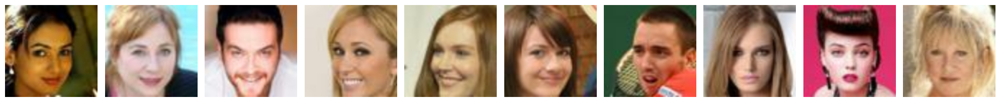

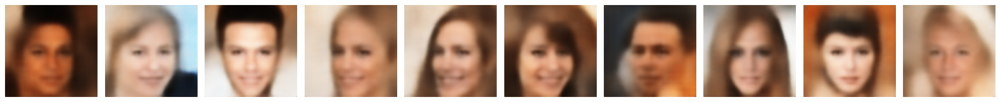

In [22]:
plot_batch(test_images, max_img=10)
plot_batch(decoded_imgs, max_img=10)

# Generating New Images

By sampling the latent space, new images can be generated.

## Principal Component Analysis

Extract the principal components from the latent space and sample across them to understand the influence of each component. The major ones (top rows of the plot below) affect mostly the background, lighting and hair color, as these take in the largest portion of the image. Actual facial features like the shape of the chin, or whether the person smiles, come later (bottom rows).

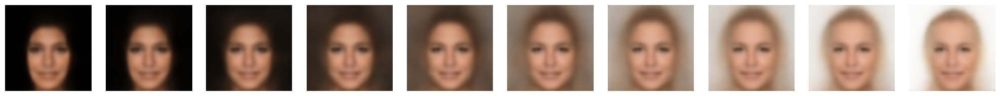

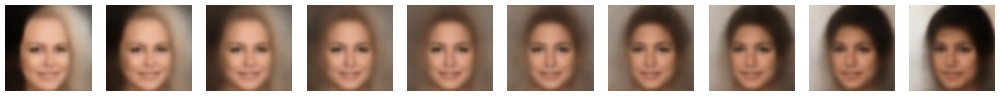

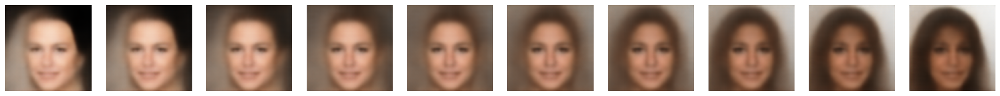

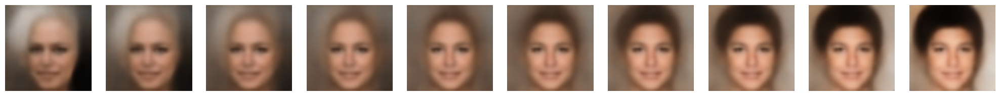

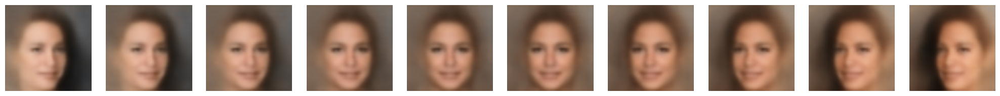

...

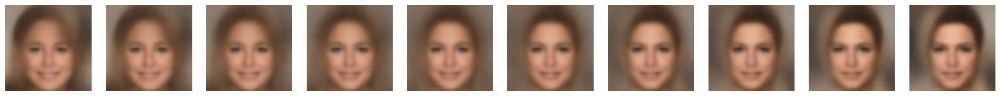

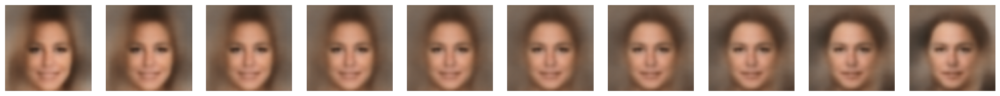

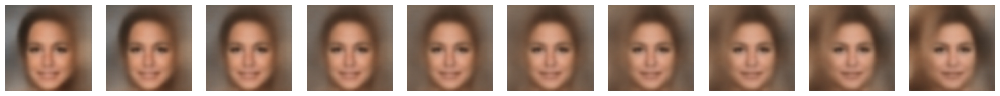

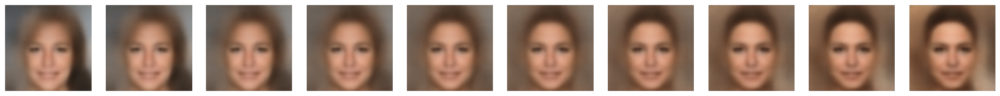

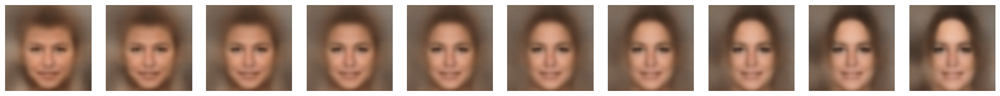

In [23]:
from sklearn.decomposition import PCA

NUM_DIMS = 20
NUM_SAMPLES = 10
SIGMA = 0.1

pca = PCA(n_components=NUM_DIMS)
pca.fit(encoded_imgs)

for dim in range(NUM_DIMS):
    arr = np.zeros((NUM_SAMPLES, NUM_DIMS))
    variance = pca.singular_values_[dim]
    arr[:, dim] = np.linspace(-SIGMA*variance, SIGMA*variance, NUM_SAMPLES)

    samples = pca.inverse_transform(arr)

    decoded_samples = model.decoder(samples)
    plot_batch(decoded_samples)

Text(0.5, 1.0, 'Feature importance')

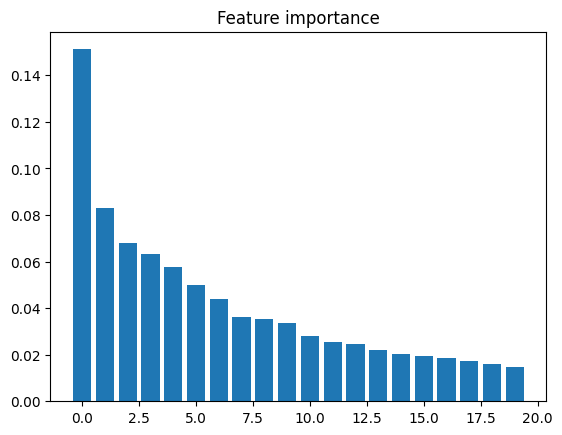

In [24]:
importance = pca.explained_variance_ratio_
plt.bar(x=range(0, len(importance)), height=importance)
plt.title("Feature importance")

## Random Sampling

Picking random samples from the latent space to generate completely new images. Using the mean and components of the PCA ensures that the samples remain within the distribution that the model can handle.

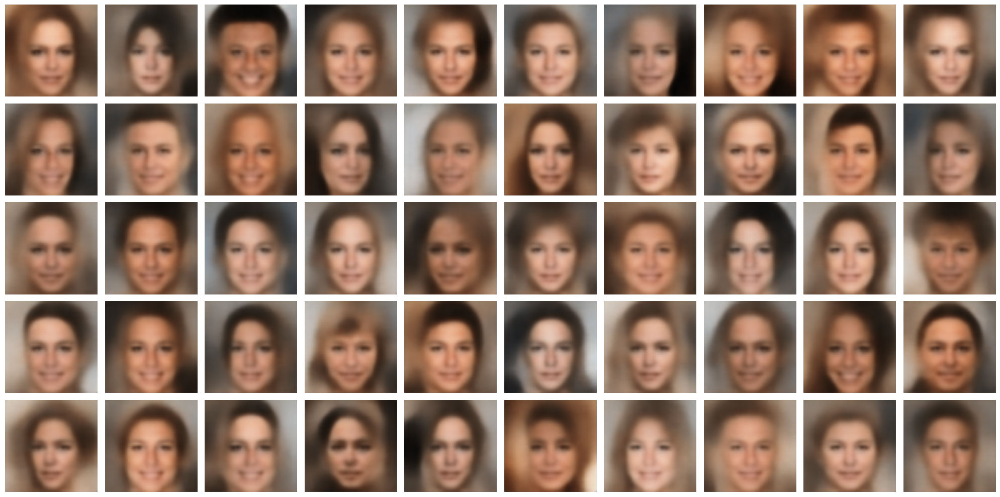

In [25]:
NUM_SAMPLES = 50

random = np.random.randn(NUM_SAMPLES, NUM_DIMS) * 0.01
samples = pca.mean_ + np.dot(random, pca.components_)

decoded_samples = model.decoder(samples)

plot_batch(decoded_samples)

Feel free to comment or ask questions!

/var/folders/v9/y2qkf5bd43gg37qjgt5sfhvc0000gn/T/ipykernel_634/2131018940.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 20/cols*rows))


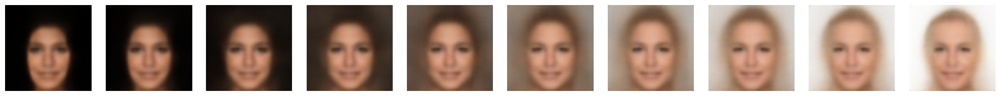

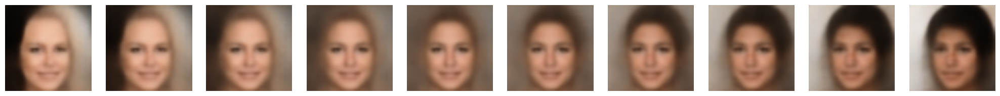

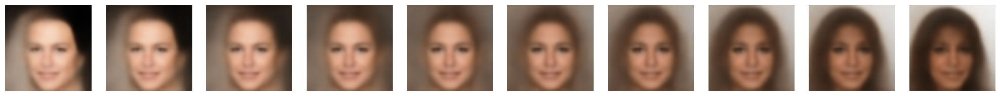

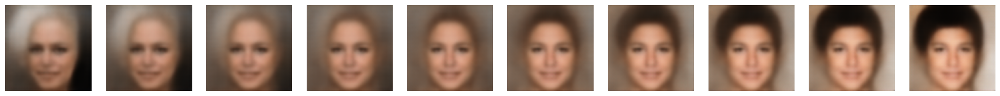

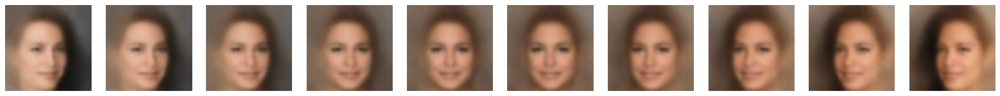

...

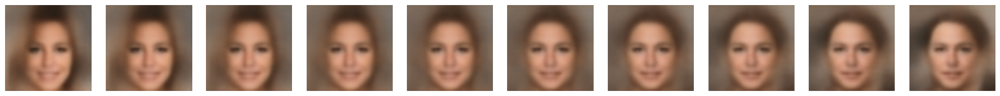

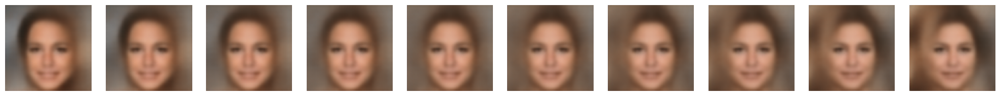

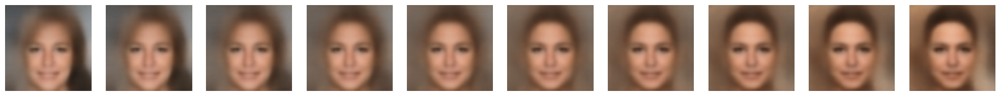

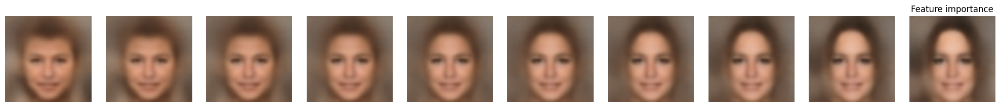

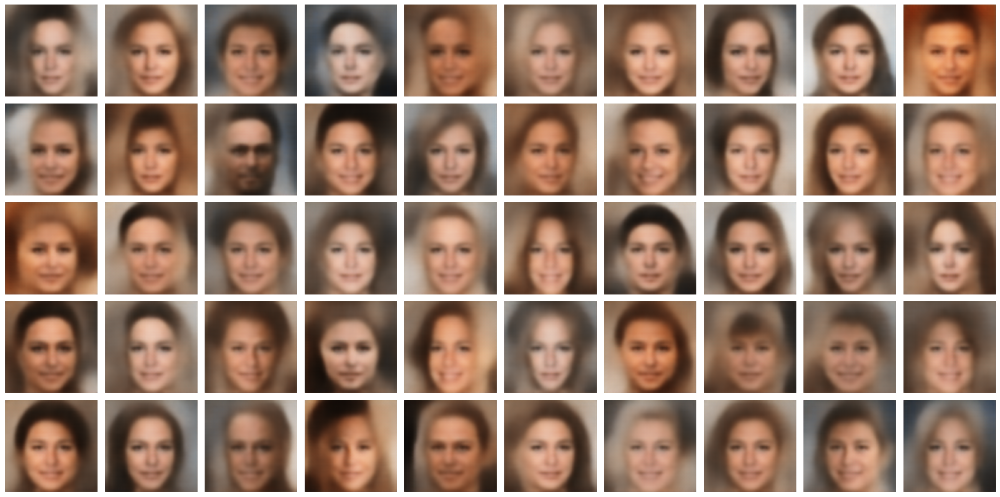

In [26]:
# Generating New Images

# By sampling the latent space, new images can be generated.

## Principal Component Analysis

# Extract the principal components from the latent space and sample across them to understand the influence of each component. The major ones (top rows of the plot below) affect mostly the background, lighting and hair color, as these take in the largest portion of the image. Actual facial features like the shape of the chin, or whether the person smiles, come later (bottom rows).

from sklearn.decomposition import PCA

NUM_DIMS = 20
NUM_SAMPLES = 10
SIGMA = 0.1

pca = PCA(n_components=NUM_DIMS)
pca.fit(encoded_imgs)

for dim in range(NUM_DIMS):
    arr = np.zeros((NUM_SAMPLES, NUM_DIMS))
    variance = pca.singular_values_[dim]
    arr[:, dim] = np.linspace(-SIGMA*variance, SIGMA*variance, NUM_SAMPLES)

    samples = pca.inverse_transform(arr)

    decoded_samples = model.decoder(samples)
    plot_batch(decoded_samples)

importance = pca.explained_variance_ratio_
plt.bar(x=range(0, len(importance)), height=importance)
plt.title("Feature importance")

## Random Sampling

# Picking random samples from the latent space to generate completely new images. Using the mean and components of the PCA ensures that the samples remain within the distribution that the model can handle.

NUM_SAMPLES = 50

random = np.random.randn(NUM_SAMPLES, NUM_DIMS) * 0.01
samples = pca.mean_ + np.dot(random, pca.components_)

decoded_samples = model.decoder(samples)

plot_batch(decoded_samples)

# Feel free to comment or ask questions!

In [2]:
import cv2
import typing
import numpy as np

from tools.inferenceModel import OnnxInferenceModel
from tools.text_utils import ctc_decoder, get_cer

class ImageToWordModel(OnnxInferenceModel):
    def __init__(self, char_list: typing.Union[str, list], *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.char_list = char_list

    def predict(self, image: np.ndarray):
        image = cv2.resize(image, self.input_shape[:2][::-1])

        image_pred = np.expand_dims(image, axis=0).astype(np.float32)

        preds = self.model.run(None, {self.input_name: image_pred})[0]

        text = ctc_decoder(preds, self.char_list)[0]

        return text


if __name__ == "__main__":
    import pandas as pd
    from tqdm import tqdm
    from tools.configs import BaseModelConfigs
    
    configs = BaseModelConfigs.load("Models/text_in_the_wild/202309022335/configs.yaml")

    model = ImageToWordModel(model_path=configs.model_path, char_list=configs.vocab)

    df = pd.read_csv("Models/text_in_the_wild/202309022335/val_data.csv").dropna().values.tolist()

    accum_cer = []
    for image_path, label in tqdm(df[60:70]):
        image = cv2.imread(image_path)

        try:
            prediction_text = model.predict(image)

            cer = get_cer(prediction_text, label)
            print(f"Image: {image_path}, Label: {label}, Prediction: {prediction_text}, CER: {cer}")

            # resize image by 3 times for visualization
            image = cv2.resize(image, (image.shape[1] * 3, image.shape[0] * 3))
            cv2.imshow(prediction_text, image)
            cv2.waitKey(0)
            cv2.destroyAllWindows()
        except:
            continue
        
        accum_cer.append(cer)

    print(f"Average CER: {np.average(accum_cer)}")

ModuleNotFoundError: No module named 'cv2'